## obtain_masks.ipynb

### Author: Indu Panigrahi

This notebook generates masks for an image dataset using a Mask R-CNN model with the <a href=https://github.com/facebookresearch/detectron2/blob/master/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml>ResNet-101 FPN 3x backbone</a> and stores them in a directory specified by the user. <br>
Info about model trained: LR of 0.001 for 2000 iterations followed by LR of 0.00025 for 8000 iterations. Detectron2 does not have a definition for epochs. Trained on 12 images from Labrador, Ketza, and Giant Ooids datasets. Trained on 2 classes, 1.5 (Archaeocyathids) and 3.2 (Everything else, originally meant for Red Mud). <br>

### Setup

In [ ]:
!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

In [2]:
# check pytorch installation: 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")   # please manually install torch 1.8 if Colab changes its default version

1.8.0+cu101 True


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [4]:
'''
You do not need to run this code cell if you're not using Google Drive for anything.
'''
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Register dataset

In [2]:
import glob
import pickle as pkl
import os
'''
You can run this code cell to put all the image file names in a directory into a 
pickled list. This can be useful when you frequently load image names.
'''

PATH_TO_IMAGE_DIR = '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/'
IM_NAMES_PKL = '/content/drive/MyDrive/Colab Notebooks/filenames.pkl'

im_names = glob.glob(os.path.join(PATH_TO_IMAGE_DIR, '*'))
with open(IM_NAMES_PKL, 'wb') as f:
    pkl.dump(im_names, f)

# check that all images loaded
with open(IM_NAMES_PKL, 'rb') as f:
    print(len(pkl.load(f)))

3452


In [8]:
import pickle as pkl

'''
Returns the dataset formatted as per https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#register-a-dataset.
'''
def process_stack_dataset():
  '''
  Set the image heights and widths as necessary. In my case, all were the same.
  '''
  IM_HEIGHT = 3173
  IM_WIDTH = 4809
  '''
  I had stored a list of the absolute path names of the image files in a pickle file.
  An easy way to do this is by putting all the images in a directory and using the 
  glob module (https://docs.python.org/3/library/glob.html) as shown in the previous code cell.
  '''
  IM_NAMES_PKL = '/content/drive/MyDrive/Colab Notebooks/filenames.pkl'
  with open(IM_NAMES_PKL, 'rb') as f:
    file_names = pkl.load(f)
  dataset_dict = []
  id = 15
  for im in file_names:
    im_dict = {}
    im_dict['file_name'] = im
    im_dict['height'] = IM_HEIGHT
    im_dict['width'] = IM_WIDTH
    im_dict['image_id'] = id        # id's must be unique
    id+=1
    dataset_dict.append(im_dict)
  '''
  I sorted the image file names because I needed to run this in different sessions 
  and needed to keep track of which masks were already generated.
  The following line of code can be removed or adapted to your own dataset.
  '''
  dataset_dict = sorted(dataset_dict, key=lambda k: int(k['file_name'][-10:-4]))
  # checking
  for i in range(len(dataset_dict)):
    print("i is: ",i ,"image is: ", int(dataset_dict[i]['file_name'][-10:-4]))
  return dataset_dict

In [9]:
images = process_stack_dataset()

i is:  0 image is:  102683
i is:  1 image is:  102684
i is:  2 image is:  102685
i is:  3 image is:  102686
i is:  4 image is:  102687
i is:  5 image is:  102688
i is:  6 image is:  102689
i is:  7 image is:  102690
i is:  8 image is:  102691
i is:  9 image is:  102692
i is:  10 image is:  102693
i is:  11 image is:  102694
i is:  12 image is:  102695
i is:  13 image is:  102696
i is:  14 image is:  102697
i is:  15 image is:  102698
i is:  16 image is:  102699
i is:  17 image is:  102700
i is:  18 image is:  102701
i is:  19 image is:  102702
i is:  20 image is:  102703
i is:  21 image is:  102704
i is:  22 image is:  102705
i is:  23 image is:  102706
i is:  24 image is:  102707
i is:  25 image is:  102708
i is:  26 image is:  102709
i is:  27 image is:  102710
i is:  28 image is:  102711
i is:  29 image is:  102712
i is:  30 image is:  102713
i is:  31 image is:  102714
i is:  32 image is:  102715
i is:  33 image is:  102716
i is:  34 image is:  102717
i is:  35 image is:  102718
i 

In [4]:
images[999]

{'file_name': '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/labrador_r02105782.tif',
 'height': 3173,
 'image_id': 1014,
 'width': 4809}

In [5]:
int(images[0]['file_name'][-8:-4])

4783

In [ ]:
for i in range(len(images)):
  print(int(images[i]['file_name'][-10:-4]))

In [8]:
sorted_images = sorted(images, key=lambda k: int(k['file_name'][-10:-4]))

In [12]:
for i in range(len(sorted_images)):
  print("i is: ",i ,"image is: ", int(sorted_images[i]['file_name'][-10:-4]))

i is:  0 image is:  102683
i is:  1 image is:  102684
i is:  2 image is:  102685
i is:  3 image is:  102686
i is:  4 image is:  102687
i is:  5 image is:  102688
i is:  6 image is:  102689
i is:  7 image is:  102690
i is:  8 image is:  102691
i is:  9 image is:  102692
i is:  10 image is:  102693
i is:  11 image is:  102694
i is:  12 image is:  102695
i is:  13 image is:  102696
i is:  14 image is:  102697
i is:  15 image is:  102698
i is:  16 image is:  102699
i is:  17 image is:  102700
i is:  18 image is:  102701
i is:  19 image is:  102702
i is:  20 image is:  102703
i is:  21 image is:  102704
i is:  22 image is:  102705
i is:  23 image is:  102706
i is:  24 image is:  102707
i is:  25 image is:  102708
i is:  26 image is:  102709
i is:  27 image is:  102710
i is:  28 image is:  102711
i is:  29 image is:  102712
i is:  30 image is:  102713
i is:  31 image is:  102714
i is:  32 image is:  102715
i is:  33 image is:  102716
i is:  34 image is:  102717
i is:  35 image is:  102718
i 

In [ ]:
from detectron2.data import DatasetCatalog
DatasetCatalog.register("stack", process_stack_dataset)

### Predict the instance masks

In [ ]:
'''
Set configs and predictor.
'''
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/detectron2_checkpoints/resnet101_fpn_backbone"
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7 # set a custom testing threshold

predictor = DefaultPredictor(cfg)
dataset_dicts = DatasetCatalog.get("stack")

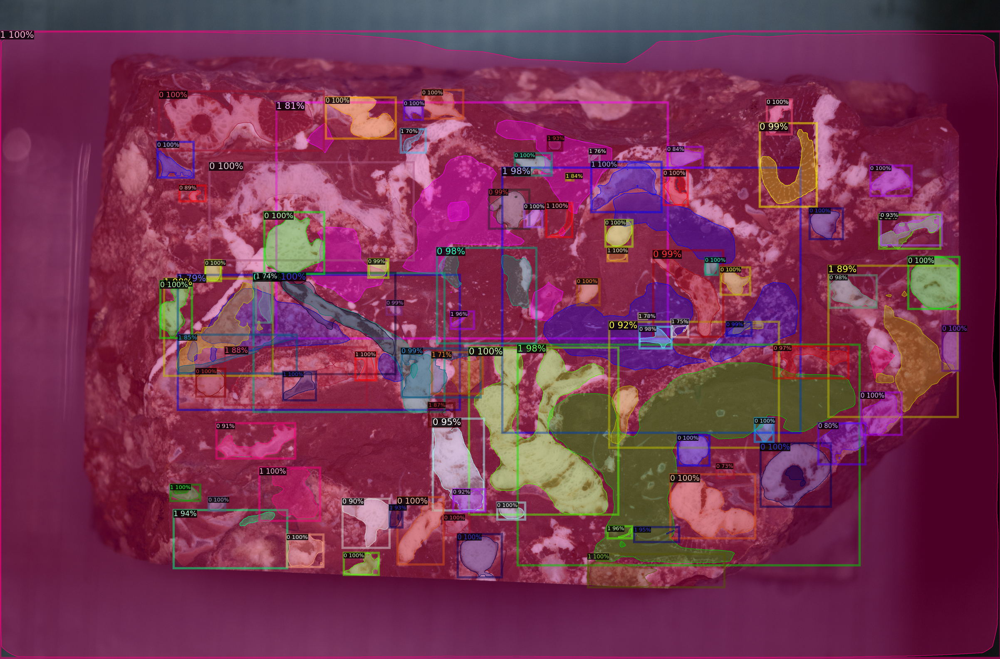

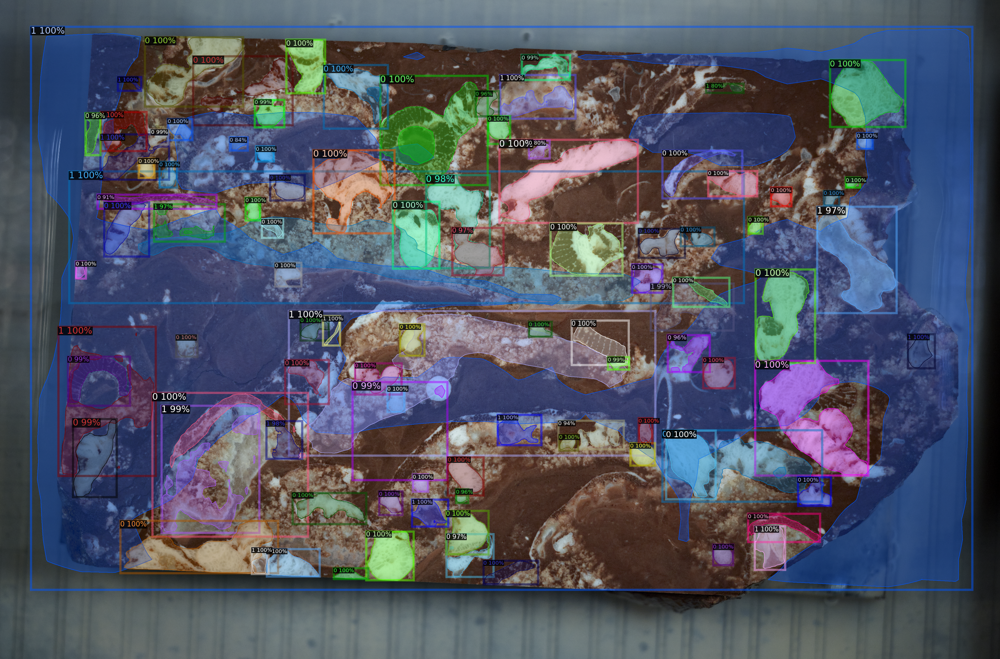

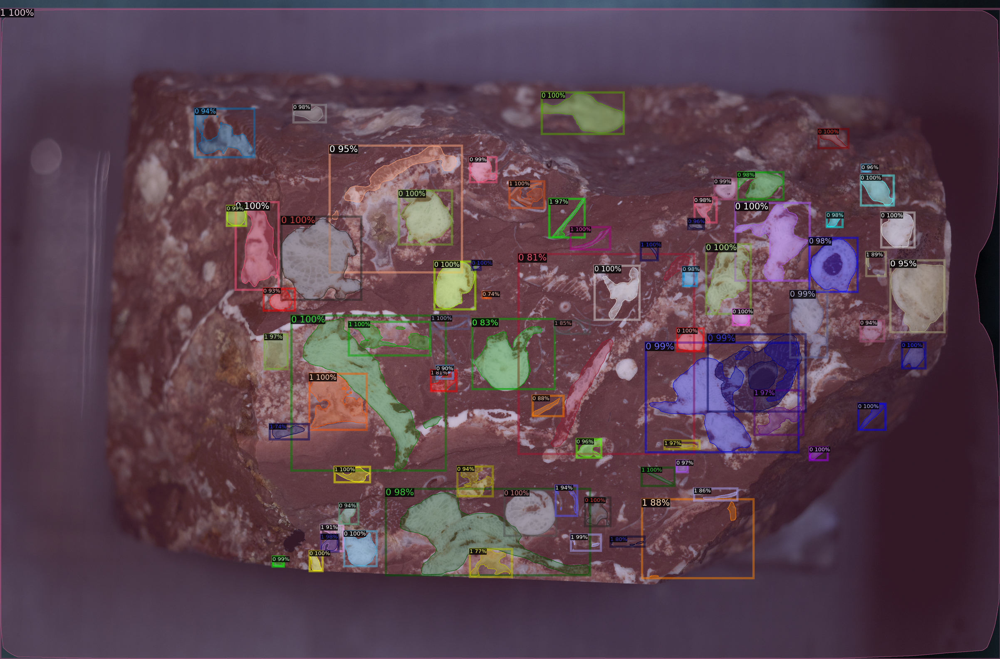

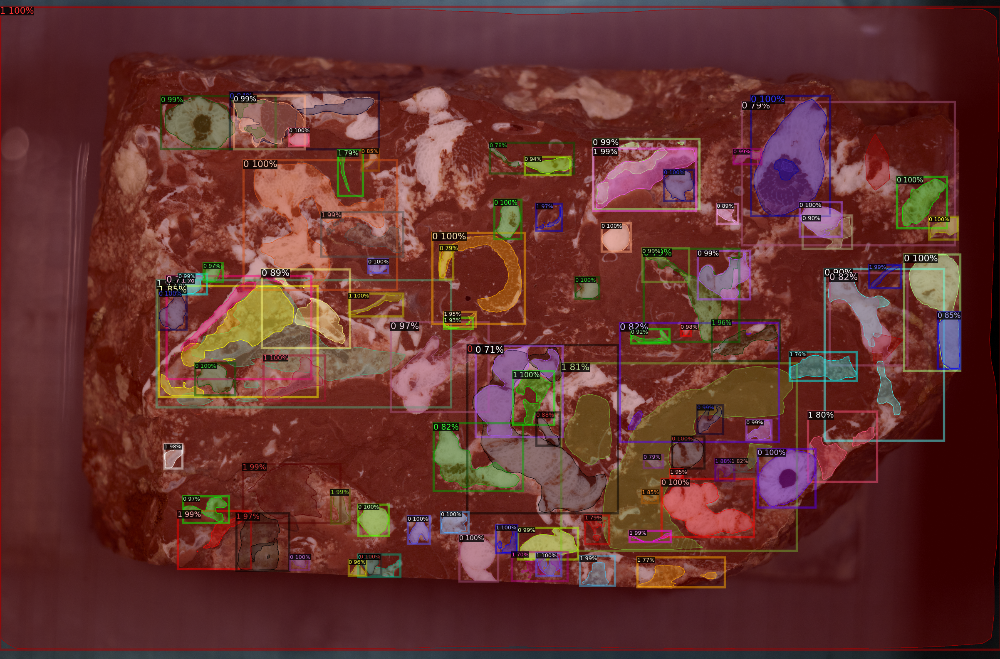

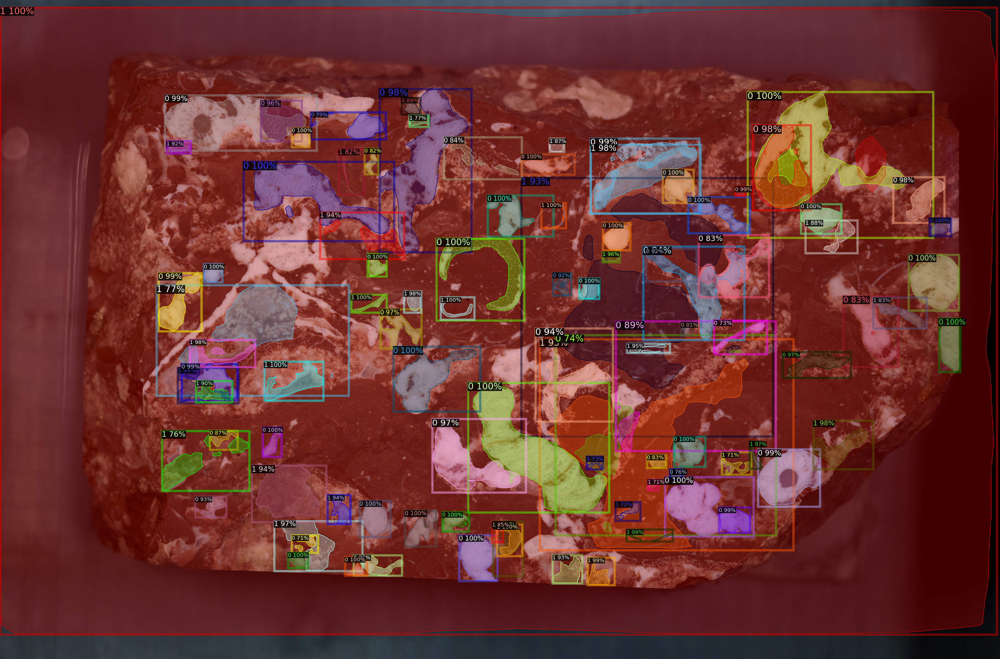

In [ ]:
from detectron2.utils.visualizer import ColorMode
'''
Visualizes prediction for SAMPLE_NUM samples.
'''
SAMPLE_NUM = 5
for d in random.sample(dataset_dicts, SAMPLE_NUM):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=MetadataCatalog.get("stack"), 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [12]:
import numpy as np
from PIL import Image
'''
Produces and stores mask image in MASK_DIR for every image in the dataset.
Naming scheme: labrador_r02103116.tif -> labrador_r02103116_mask.tif
'''

MASK_DIR = '/content/drive/MyDrive/Colab Notebooks/masks_0_to_500/'
IM_HEIGHT = 3173
IM_WIDTH = 4809
for i,d in enumerate(dataset_dicts):
  print('Iteration:',i,'\tImage:',d["file_name"][-15:])
  # run inference on an image
  im_name = d["file_name"]
  im = cv2.imread(im_name)
  outputs = predictor(im)
  '''
  Note: 'outputs' contains even more information, such as bounding boxes, than what is needed in this notebook.
  See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for more information.
  '''

  # combine the predicted instance masks
  final_mask = torch.zeros([IM_HEIGHT,IM_WIDTH], dtype=torch.bool)
  for i in range(len(outputs["instances"].pred_masks.to("cpu"))):
    # 0 was the Archaeocyathid class for my dataset
    if outputs["instances"].pred_classes.to("cpu")[i] == 0:
      final_mask = torch.logical_or(final_mask, outputs["instances"].pred_masks[i].to("cpu"))
  
  # convert to grayscale binary mask
  final_image = final_mask.to("cpu").long()
  final_image*=255

  # store
  '''
  The images file names I used were of the format 
  '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/labrador_r02102683.tif'
  You can change the following lines of code to change the naming scheme.
  '''
  im_name = str.split(str.split(im_name, sep='/')[-1], sep='.')
  grayscale_image = Image.fromarray(np.uint8(final_image.numpy()),'L').save(MASK_DIR + im_name[0] + '_mask.tif')

  if i == 500:
    break

Iteration: 0 	Image: r_r02102683.tif
Iteration: 1 	Image: r_r02102684.tif
Iteration: 2 	Image: r_r02102685.tif
Iteration: 3 	Image: r_r02102686.tif
Iteration: 4 	Image: r_r02102687.tif
Iteration: 5 	Image: r_r02102688.tif
Iteration: 6 	Image: r_r02102689.tif
Iteration: 7 	Image: r_r02102690.tif
Iteration: 8 	Image: r_r02102691.tif
Iteration: 9 	Image: r_r02102692.tif
Iteration: 10 	Image: r_r02102693.tif
Iteration: 11 	Image: r_r02102694.tif
Iteration: 12 	Image: r_r02102695.tif
Iteration: 13 	Image: r_r02102696.tif
Iteration: 14 	Image: r_r02102697.tif
Iteration: 15 	Image: r_r02102698.tif
Iteration: 16 	Image: r_r02102699.tif
Iteration: 17 	Image: r_r02102700.tif
Iteration: 18 	Image: r_r02102701.tif
Iteration: 19 	Image: r_r02102702.tif
Iteration: 20 	Image: r_r02102703.tif
Iteration: 21 	Image: r_r02102704.tif
Iteration: 22 	Image: r_r02102705.tif
Iteration: 23 	Image: r_r02102706.tif
Iteration: 24 	Image: r_r02102707.tif
Iteration: 25 	Image: r_r02102708.tif
Iteration: 26 	Image: 

KeyboardInterrupt: ignored

In [13]:
import numpy as np
from PIL import Image
'''
Produces and stores mask image in MASK_DIR for every image in the dataset.
Naming scheme: labrador_r02103116.tif -> labrador_r02103116_mask.tif
'''

MASK_DIR = '/content/drive/MyDrive/Colab Notebooks/masks_501_to_1100/'
IM_HEIGHT = 3173
IM_WIDTH = 4809
for i,d in enumerate(dataset_dicts[501:1101]):
  print('Iteration:',i,'\tImage:',d["file_name"][-15:])
  # run inference on an image
  im_name = d["file_name"]
  im = cv2.imread(im_name)
  outputs = predictor(im)
  '''
  Note: 'outputs' contains even more information, such as bounding boxes, than what is needed in this notebook.
  See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for more information.
  '''

  # combine the predicted instance masks
  final_mask = torch.zeros([IM_HEIGHT,IM_WIDTH], dtype=torch.bool)
  for i in range(len(outputs["instances"].pred_masks.to("cpu"))):
    # 0 was the Archaeocyathid class for my dataset
    if outputs["instances"].pred_classes.to("cpu")[i] == 0:
      final_mask = torch.logical_or(final_mask, outputs["instances"].pred_masks[i].to("cpu"))
  
  # convert to grayscale binary mask
  final_image = final_mask.to("cpu").long()
  final_image*=255

  # store
  '''
  The images file names I used were of the format 
  '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/labrador_r02102683.tif'
  You can change the following lines of code to change the naming scheme.
  '''
  im_name = str.split(str.split(im_name, sep='/')[-1], sep='.')
  grayscale_image = Image.fromarray(np.uint8(final_image.numpy()),'L').save(MASK_DIR + im_name[0] + '_mask.tif')

Iteration: 0 	Image: r_r02103184.tif
Iteration: 1 	Image: r_r02103185.tif
Iteration: 2 	Image: r_r02103186.tif
Iteration: 3 	Image: r_r02103187.tif
Iteration: 4 	Image: r_r02103188.tif
Iteration: 5 	Image: r_r02103189.tif
Iteration: 6 	Image: r_r02103190.tif
Iteration: 7 	Image: r_r02103191.tif
Iteration: 8 	Image: r_r02103192.tif
Iteration: 9 	Image: r_r02103193.tif
Iteration: 10 	Image: r_r02103194.tif
Iteration: 11 	Image: r_r02103195.tif
Iteration: 12 	Image: r_r02103196.tif
Iteration: 13 	Image: r_r02103197.tif
Iteration: 14 	Image: r_r02103198.tif
Iteration: 15 	Image: r_r02103199.tif
Iteration: 16 	Image: r_r02103200.tif
Iteration: 17 	Image: r_r02103201.tif
Iteration: 18 	Image: r_r02103202.tif
Iteration: 19 	Image: r_r02103203.tif
Iteration: 20 	Image: r_r02103204.tif
Iteration: 21 	Image: r_r02103205.tif
Iteration: 22 	Image: r_r02103206.tif
Iteration: 23 	Image: r_r02103207.tif
Iteration: 24 	Image: r_r02103208.tif
Iteration: 25 	Image: r_r02103209.tif
Iteration: 26 	Image: 

In [14]:
import numpy as np
from PIL import Image
'''
Produces and stores mask image in MASK_DIR for every image in the dataset.
Naming scheme: labrador_r02103116.tif -> labrador_r02103116_mask.tif
'''

MASK_DIR = '/content/drive/MyDrive/Colab Notebooks/masks_1709_to_2099/'
IM_HEIGHT = 3173
IM_WIDTH = 4809
for i,d in enumerate(dataset_dicts[1709:2100]):
  print('Iteration:',i,'\tImage:',d["file_name"][-12:])
  # run inference on an image
  im_name = d["file_name"]
  im = cv2.imread(im_name)
  outputs = predictor(im)
  '''
  Note: 'outputs' contains even more information, such as bounding boxes, than what is needed in this notebook.
  See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for more information.
  '''

  # combine the predicted instance masks
  final_mask = torch.zeros([IM_HEIGHT,IM_WIDTH], dtype=torch.bool)
  for i in range(len(outputs["instances"].pred_masks.to("cpu"))):
    # 0 was the Archaeocyathid class for my dataset
    if outputs["instances"].pred_classes.to("cpu")[i] == 0:
      final_mask = torch.logical_or(final_mask, outputs["instances"].pred_masks[i].to("cpu"))
  
  # convert to grayscale binary mask
  final_image = final_mask.to("cpu").long()
  final_image*=255

  # store
  '''
  The images file names I used were of the format 
  '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/labrador_r02102683.tif'
  You can change the following lines of code to change the naming scheme.
  '''
  im_name = str.split(str.split(im_name, sep='/')[-1], sep='.')
  grayscale_image = Image.fromarray(np.uint8(final_image.numpy()),'L').save(MASK_DIR + im_name[0] + '_mask.tif')\

Iteration: 0 	Image: 02104392.tif
Iteration: 1 	Image: 02104393.tif
Iteration: 2 	Image: 02104394.tif
Iteration: 3 	Image: 02104395.tif
Iteration: 4 	Image: 02104396.tif
Iteration: 5 	Image: 02104397.tif
Iteration: 6 	Image: 02104398.tif
Iteration: 7 	Image: 02104399.tif
Iteration: 8 	Image: 02104400.tif
Iteration: 9 	Image: 02104401.tif
Iteration: 10 	Image: 02104402.tif
Iteration: 11 	Image: 02104403.tif
Iteration: 12 	Image: 02104404.tif
Iteration: 13 	Image: 02104405.tif
Iteration: 14 	Image: 02104406.tif
Iteration: 15 	Image: 02104407.tif
Iteration: 16 	Image: 02104408.tif
Iteration: 17 	Image: 02104409.tif
Iteration: 18 	Image: 02104410.tif
Iteration: 19 	Image: 02104411.tif
Iteration: 20 	Image: 02104412.tif
Iteration: 21 	Image: 02104413.tif
Iteration: 22 	Image: 02104414.tif
Iteration: 23 	Image: 02104415.tif
Iteration: 24 	Image: 02104416.tif
Iteration: 25 	Image: 02104417.tif
Iteration: 26 	Image: 02104418.tif
Iteration: 27 	Image: 02104419.tif
Iteration: 28 	Image: 02104420

In [21]:
import numpy as np
from PIL import Image
'''
Produces and stores mask image in MASK_DIR for every image in the dataset.
Naming scheme: labrador_r02103116.tif -> labrador_r02103116_mask.tif
'''

MASK_DIR = '/content/drive/MyDrive/Colab Notebooks/masks_3100_to_3451/'
IM_HEIGHT = 3173
IM_WIDTH = 4809
for i,d in enumerate(dataset_dicts[3401:3452]):
  print('Iteration:',i,'\tImage:',d["file_name"][-11:])

  # run inference on an image
  im_name = d["file_name"]
  im = cv2.imread(im_name)
  outputs = predictor(im)
  '''
  Note: 'outputs' contains even more information, such as bounding boxes, than what is needed in this notebook.
  See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for more information.
  '''

  # combine the predicted instance masks
  final_mask = torch.zeros([IM_HEIGHT,IM_WIDTH], dtype=torch.bool)
  for i in range(len(outputs["instances"].pred_masks.to("cpu"))):
    # 0 was the Archaeocyathid class for my dataset
    if outputs["instances"].pred_classes.to("cpu")[i] == 0:
      final_mask = torch.logical_or(final_mask, outputs["instances"].pred_masks[i].to("cpu"))
  
  # convert to grayscale binary mask
  final_image = final_mask.to("cpu").long()
  final_image*=255

  # store
  '''
  The images file names I used were of the format 
  '/content/drive/.shortcut-targets-by-id/1eE2KjmNnZ8htvskIC8-WfkgDh7a8qZvN/maloof_group_summer_2021/archaeocyathid_3d_stacks/labrador_r02/Output/labrador_r02102683.tif'
  You can change the following lines of code to change the naming scheme.
  '''
  im_name = str.split(str.split(im_name, sep='/')[-1], sep='.')
  grayscale_image = Image.fromarray(np.uint8(final_image.numpy()),'L').save(MASK_DIR + im_name[0] + '_mask.tif')\

Iteration: 0 	Image: 0297452.tif
Iteration: 1 	Image: 0297453.tif
Iteration: 2 	Image: 0297454.tif
Iteration: 3 	Image: 0297455.tif
Iteration: 4 	Image: 0297456.tif
Iteration: 5 	Image: 0297457.tif
Iteration: 6 	Image: 0297458.tif
Iteration: 7 	Image: 0297459.tif
Iteration: 8 	Image: 0297460.tif
Iteration: 9 	Image: 0297461.tif
Iteration: 10 	Image: 0297462.tif
Iteration: 11 	Image: 0297463.tif
Iteration: 12 	Image: 0297464.tif
Iteration: 13 	Image: 0297465.tif
Iteration: 14 	Image: 0297466.tif
Iteration: 15 	Image: 0297467.tif
Iteration: 16 	Image: 0297468.tif
Iteration: 17 	Image: 0297469.tif
Iteration: 18 	Image: 0297470.tif
Iteration: 19 	Image: 0297471.tif
Iteration: 20 	Image: 0297472.tif
Iteration: 21 	Image: 0297473.tif
Iteration: 22 	Image: 0297474.tif
Iteration: 23 	Image: 0297475.tif
Iteration: 24 	Image: 0297476.tif
Iteration: 25 	Image: 0297477.tif
Iteration: 26 	Image: 0297478.tif
Iteration: 27 	Image: 0297479.tif
Iteration: 28 	Image: 0297480.tif
Iteration: 29 	Image: 02